# CV: Annex
Documents learning experiments done as part of the project.

#### Imports

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
plt.style.use('seaborn')

#### Filters

We all know filters do stuff. What does filters look like and what do they do?

Below are illustrations of how this is done in OpenCV (`cv2`) with the help of Michelle Dockery from Downton Abbey.

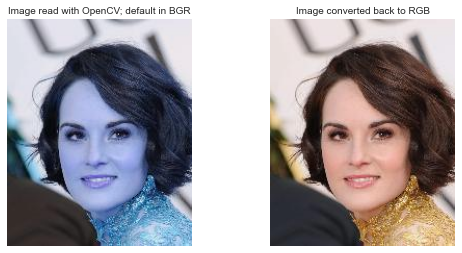

In [2]:
# read in image
loaded_img = cv2.imread('./img_filter_experiment.jpg')

# set up subplots
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2)
fig.tight_layout(pad=5)

# show image read from source
ax1.imshow(loaded_img)
ax1.set_title('Image read with OpenCV; default in BGR', fontsize=10)
ax1.axis("off")

# show image after color change
# cv2 uses BGR instead of RGB; fix this via cvtColor
loaded_img = cv2.cvtColor(loaded_img,cv2.COLOR_BGR2RGB)
ax2.imshow(loaded_img)
ax2.set_title('Image converted back to RGB', fontsize=10)
ax2.axis("off")

plt.show()

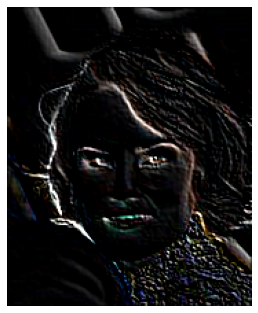

In [3]:
# emboss
Emboss_Kernel = np.array([
    [0,-1,-1],
    [1,0,-1],
    [1,1,0]
])
Emboss_Effect_Img = cv2.filter2D(src=loaded_img, kernel=Emboss_Kernel, ddepth=-1)
plt.imshow(Emboss_Effect_Img,cmap="gray")
plt.axis("off")
plt.show()

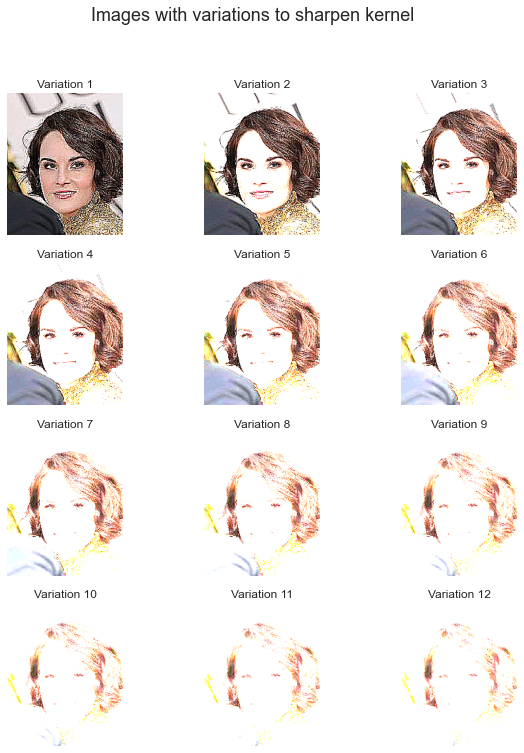

In [4]:
# sharpen
sharpened_imgs = []

fig, ax = plt.subplots(4, 3, figsize=(10, 12))
plt.suptitle('Images with variations to sharpen kernel',
             fontsize=18)

for n in range(0, 12):
    Sharpen_Kernel = np.array([
        [n*0.1-1, n*0.1-1, n*0.1-1],
        [n*0.1-1, 9,       n*0.1-1],
        [n*0.1-1, n*0.1-1, n*0.1-1]
    ])
    sharpened_img = cv2.filter2D(
        src=loaded_img,
        kernel=Sharpen_Kernel,
        ddepth=-1)

    # add a new subplot iteratively
    ax = plt.subplot(4, 3, n + 1)
    ax.imshow(sharpened_img)
    ax.set_title(f'Variation {n + 1}')
    ax.axis('off')
    
plt.show()

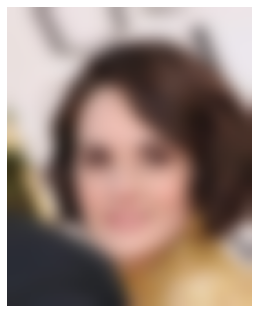

In [5]:
# cv2 in-built Gaussian Blur filter
Blur_Effect_Img = cv2.GaussianBlur(loaded_img, (35, 35), 0)
plt.imshow(Blur_Effect_Img,cmap="gray")
plt.axis("off")
plt.show()

#### Getting to a sliding window...
Brute force method for feature extraction

In [6]:
# read the image and define the stepSize and window size 
# (width,height)
image = cv2.cvtColor(cv2.imread("./img_filter_experiment.jpg"), cv2.COLOR_BGR2RGB) # your image path
# define an image copy for drawing
tmp = image
step_size = 5
(w_width, w_height) = (100, 100) # window size

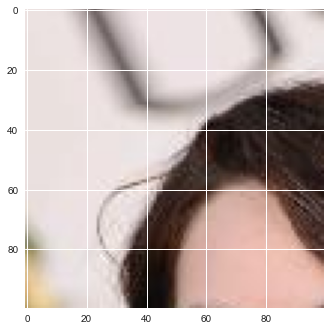

In [7]:
# show cropped window; define initial x, y values
# this is read from top left
x, y = 0, 0
# image parameters takes height first then width
plt.imshow(image[y : (y + w_height) , x : (x + w_width)]);

In [8]:
# count number of windows expected
# initialize counter
windows_max = 0
for x in range(0, image.shape[1] - w_width , step_size):
    for y in range(0, image.shape[0] - w_height, step_size):
        windows_max += 1
print(f'{windows_max} windows expected')

384 windows expected


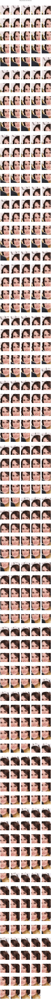

<Figure size 576x396 with 0 Axes>

In [9]:
# draw sliding window frames
count = 0
plt.figure(figsize=(16,300))
plt.suptitle(f'Sliding Windows with {windows_max} frames',
             fontsize=18, y=1)
for x in range(0, image.shape[1] - w_width , step_size):
    for y in range(0, image.shape[0] - w_height, step_size):
        window = image[y : y + w_height,
                       x : x + w_width,
                       :]
        count += 1
        n_columns = 5
        ax = plt.subplot(int(np.ceil(windows_max/n_columns)),
                         n_columns,
                         count)
        ax.set_title(count)
        ax.imshow(np.array(window).astype('uint8'))
        plt.axis('off')
plt.tight_layout(pad=3)
plt.show()

*How it works*
1. Window size has been pre-defined.
1. Window "slides" by the `step_size` step-wise along the y-axis by each step size
1. On reaching the image bottom-left border, the window slides back to the top and takes a step to the right along the x-axis.
1. This is repeated until the whole image is covered.

In theory, a classifier and object detector can be added into each loop, and if so, outline the window. However, this is understandably quite inefficient and computationally costly.

For example, adding the classifier and detector will outline detected objects many many times if the window size is too large, and miss many objects if the window is too small. 

### Learning: Papers

#### HOG and Linear SVM
<font color='gray'><i>I learnt about this from: https://pyimagesearch.com/2014/11/10/histogram-oriented-gradients-object-detection/</i></font>
    
- HOG: Histogram of Oriented Gradients
- SVM: Support Vector Machines


**Key Paper**: Dalal, Naveneet, and Bill Triggs. Histograms of Oriented Gradients for Human Detection - INRIA. 2005, https://lear.inrialpes.fr/people/triggs/pubs/Dalal-cvpr05.pdf. 

The following cells are appended for potential future use as a "to do list".

In [10]:
# draw rectangle and show
# cv2.rectangle(img=tmp,
#               pt1=(x, y),
#               pt2=(x + w_width, y + w_height),
#               color=(255, 0, 0),
#               thickness=2) 
# plt.imshow(tmp)
# plt.tight_layout;

In [ ]:
# Faster R-CNN (region-based convultional neural networks)
# tutorial: https://pyimagesearch.com/2020/06/22/turning-any-cnn-image-classifier-into-an-object-detector-with-keras-tensorflow-and-opencv/
batch_rcnn = 32
img_height_rcnn = 28
img_width_rcnn = 28
channels = 3
num_classes = 10 # max classes to detect via model

# https://www.quora.com/What-is-the-difference-between-CNN-and-R-CNN
model_rcnn = keras.models.Sequential([
    keras.layers.Rescaling(1./255)
    keras.layers.Conv2D(
        2, 3, activation='relu',
        input_shape=(batch_rcnn, img_height_rcnn, img_width_rcnn, channels),
        name='conv2d_1'),
    keras.layers.MaxPooling2D(
        pool_size=(2, 2),
        name='maxpool_1'),
    keras.layers.Conv2D(
        2, 3, activation='relu',
        name='conv2d_2'),
    keras.layers.MaxPooling2D(
        pool_size=(2, 2),
        name='maxpool_2'),
    keras.layers.Flatten(name='flatten_1'),
    keras.layers.Dense(
        classes_rcnn,
        activation='softmax',
        name='dense_output')
])

# what makes a "fast" r-cnn?

# Selective Search

# EdgeBoxes

